In [1]:
import pandas as pd

In [2]:
df=pd.read_csv('saber_combined_all_fields.csv')

In [3]:
df=df.rename(columns={'Unnamed: 0':'user_id'})
df.set_index('user_id',inplace=True)

In [4]:
import ast
try:
    file = open("translate_cat.txt", encoding="utf8")
    contents = file.read()
finally:
    file.close()

# get headers as dictionary 
values_lowercase = ast.literal_eval(contents.lower()) #lower case

In [5]:
import re
try:
    english_cols={}  # English columns
    with open('spanish_to_english.txt','r') as file:
        for line in file:
            line=line.replace("'",'')
            english_cols[line.split(',')[0]]=re.sub('[#]','',line.split(',')[1]).replace('\n','').lstrip().rstrip().replace(' ','_').lower()
finally:
    file.close()

In [6]:
english_cols

{'estu_tipodocumento': 'type_of_document',
 'estu_nacionalidad': 'nationality',
 'estu_genero': 'gender',
 'estu_fechanacimiento': 'birth_date',
 'estu_exterior': 'are_they_foreigns?',
 'periodo': 'period',
 'estu_consecutivo ': 'consecutive_number',
 'estu_estadocivil': 'civil_state',
 'estu_estudiante': 'is_student?',
 'estu_pais_reside': 'residing_country',
 'estu_tieneetnia': 'is_ethnic',
 'estu_depto_reside': 'state',
 'estu_cod_reside_depto': 'state_code',
 'estu_mcpio_reside': 'municipality',
 'estu_cod_reside_mcpio': 'municipality_code',
 'estu_tituloobtenidobachiller': 'did_he_finished_college?',
 'estu_ano_examenestado_sb11': 'year_of_exam',
 'estu_semestre_examenestadosb11': 'semester_of_exam',
 'estu_porcentajecreditosaprob': 'porcentage_approval_credits',
 'estu_valormatriculauniversidad': 'cost_of_college_per_semester',
 'estu_pagomatriculabeca': 'cost_of_college_by_scholarship',
 'estu_pagomatriculacredito': 'it_is_being_paid_by_credit?',
 'estu_pagomatriculapadres': 'pa

In [7]:
len(english_cols)

143

In [8]:
type(values_lowercase)

dict

In [9]:
len(values_lowercase)

83

In [10]:
# Renaming Column Values from spanish to english
object_column=df.select_dtypes(include='object').columns.to_list()
len(object_column)    

111

In [11]:
set(object_column)-set(values_lowercase.keys())

{'cole_bilingue',
 'cole_calendario',
 'cole_depto_ubicacion',
 'cole_mcpio_ubicacion',
 'cole_nombre_establecimiento',
 'cole_nombre_sede',
 'desemp_ingles',
 'desemp_prof',
 'estu_consecutivo',
 'estu_consecutivo.1',
 'estu_depto_reside',
 'estu_depto_reside.1',
 'estu_fechanacimiento',
 'estu_fechanacimiento.1',
 'estu_genero',
 'estu_genero.1',
 'estu_inst_departamento',
 'estu_inst_municipio',
 'estu_mcpio_reside',
 'estu_mcpio_reside.1',
 'estu_pais_reside',
 'estu_prgm_academico',
 'estu_prgm_departamento',
 'estu_prgm_municipio',
 'estu_tipodocumento',
 'estu_tipodocumento.1',
 'gruporeferencia',
 'inst_nombre_institucion'}

In [12]:
# Changing the column values from spanish to english
for key,value in values_lowercase.items():
    df[key]=df[key].str.lower().replace(value)

In [13]:
# Also renaming the columns names from spanish to english
df=df.rename(columns=english_cols)

In [14]:
# Lets look first row value of dataframe
for item in df.loc[0].iteritems():
    print(item)

('type_of_document', 'TI')
('nationality', 'colombia')
('gender', 'M')
('birth_date', '30/07/1996')
('are_they_foreigns?', nan)
('period', 20134)
('estu_consecutivo', 'EK201340233804')
('civil_state', 'single')
('is_student?', 'student')
('residing_country', 'COLOMBIA')
('is_ethnic', nan)
('state', 'BOYACA')
('state_code', 15.0)
('municipality', 'GUATEQUE')
('municipality_code', 15322.0)
('did_he_finished_college?', 'technical bachelor')
('year_of_exam', 2013.0)
('semester_of_exam', '1st semester')
('porcentage_approval_credits', "doesn't follow the credit system")
('cost_of_college_per_semester', 'did not pay tuition')
('cost_of_college_by_scholarship', nan)
('it_is_being_paid_by_credit?', nan)
('parents_college_paid_amount', nan)
('student_college_paid_amount', nan)
('did_student_took_preparation_test?', nan)
('took_an_special_preparation_test?', nan)
('took_another_test_thats_not_lectured_by_government?', nan)
('did_he_take_an_external_test?', nan)
('did_you_did_a_simulacrum?', nan)

In [15]:
# Remove duplicate columns from the Datframe
df=df.loc[:,~df.columns.duplicated()]

In [16]:
# Let's Look into unique value and their proportions of all the columns
for col in df.columns.to_list():
    print(df[col].value_counts())
    print('---------------------------------------------------------------------------')

CC     184884
TI      26284
CR        752
CE         83
PC          3
PE          3
NES         1
Name: type_of_document, dtype: int64
---------------------------------------------------------------------------
colombia                   211845
usa                            47
venezuela                      32
comoros                        14
spain                          12
ecuador                         6
argentina                       5
mexico                          5
north korea                     4
france                          4
italy                           3
croatia                         3
panama                          3
israel                          2
germany                         2
united kingdom                  2
porcelain                       2
palestinian territories         2
bulgaria                        1
canada                          1
vatican                         1
azerbaijan                      1
switzerland                     1
austria

no     40043
yes     5689
Name: did_student_took_preparation_test?, dtype: int64
---------------------------------------------------------------------------
he did not take a course    41864
less than 20 hours           8138
between 20 and 30 hours      7453
more than 30 hours           5101
Name: took_an_special_preparation_test?, dtype: int64
---------------------------------------------------------------------------
he did not take a course    42824
less than 20 hours          10100
between 20 and 30 hours      5926
more than 30 hours           3748
Name: took_another_test_thats_not_lectured_by_government?, dtype: int64
---------------------------------------------------------------------------
he did not take a course    44336
less than 20 hours          11707
between 20 and 30 hours      3431
more than 30 hours           2685
Name: did_he_take_an_external_test?, dtype: int64
---------------------------------------------------------------------------
no     43617
yes    19016
Name:

no     128949
yes     77705
Name: do_you_have_car?, dtype: int64
---------------------------------------------------------------------------
yes    43110
no      3958
Name: do_you_have_fridge?, dtype: int64
---------------------------------------------------------------------------
yes    43444
no      3624
Name: do_you_have_cellphone?, dtype: int64
---------------------------------------------------------------------------
26 to 100 books        53403
11 to 25 books         46314
0 to 10 books          41140
more than 100 books    22374
Name: how_much_books_do_you_have, dtype: int64
---------------------------------------------------------------------------
yes    26195
no     20616
Name: does_family_have_a_phone?, dtype: int64
---------------------------------------------------------------------------
between 1 and less than 2 smlv     23888
less than 1 smlv                   10684
between 2 and less than 3 smlv      8838
between 3 and less than 5 smlv      2741
between 5 and less th

11    104951
5      19654
8      13288
76     12866
68      9136
13      5487
54      5025
25      4298
15      3832
66      3482
17      3380
73      3266
52      3081
23      3034
19      2677
47      2550
70      2488
63      2179
41      1885
44      1179
20      1169
50      1110
27       884
18       707
86       185
85       169
88        23
81        16
99         9
Name: state_institution_code, dtype: int64
---------------------------------------------------------------------------
colombia     211987
usa               7
venezuela         5
spain             3
ecuador           2
bolivia           1
japan             1
mexico            1
panama            1
porcelain         1
italy             1
Name: type_of_nationality, dtype: int64
---------------------------------------------------------------------------
F    129885
M     82115
Name: student_gender, dtype: int64
---------------------------------------------------------------------------
20122    123028
20132     69798
2

yes    164195
no      45953
Name: do_they_have_washer?, dtype: int64
---------------------------------------------------------------------------
no     122054
yes     88094
Name: do_they_have_microwave?, dtype: int64
---------------------------------------------------------------------------
yes    112925
no      88719
Name: do_they_have_kiln?, dtype: int64
---------------------------------------------------------------------------
no     134930
yes     75217
Name: do_they_have_car?, dtype: int64
---------------------------------------------------------------------------
yes    154561
no      55587
Name: do_they_have_dvd?, dtype: int64
---------------------------------------------------------------------------
yes    199443
no      10712
Name: do_they_have_fridge?, dtype: int64
---------------------------------------------------------------------------
yes    199944
no      10211
Name: do_they_have_cellphone?, dtype: int64
---------------------------------------------------------------

score_interdisc_violence_and_soc    57168
score_interdisc_environment         56887
score_deepen_language               30124
score_deepen_mathematics            28987
score_deepen_biology                22555
score_deepen_social_science         16289
Name: saber_11_icfes_optative, dtype: int64
---------------------------------------------------------------------------
5.0     48542
6.0     34396
55.0    17974
52.0    14561
51.0    12754
        ...  
66.0        4
83.0        3
61.0        2
85.0        2
76.0        1
Name: saber_11_icfes_optative_score, Length: 63, dtype: int64
---------------------------------------------------------------------------
I      48868
II     23410
GB     22476
III     3201
Name: optative_score_category, dtype: int64
---------------------------------------------------------------------------


In [17]:
# Ascending order of NaN values in column
for i in df.columns.to_list():
    val=df[i].isnull().sum()/len(df)
    if val>0:
        print(i+':',val)

gender: 1.4150275930380643e-05
birth_date: 0.000570727795858686
are_they_foreigns?: 0.22224423376255836
civil_state: 0.3105136550162728
is_ethnic: 0.22372529597660487
state: 0.0017216169048629782
state_code: 0.0017216169048629782
municipality: 0.0017216169048629782
municipality_code: 0.0017216169048629782
did_he_finished_college?: 0.008848639215131363
year_of_exam: 0.7785010141031083
semester_of_exam: 0.7780104712041885
porcentage_approval_credits: 0.7876420923541343
cost_of_college_per_semester: 0.019079288712796565
cost_of_college_by_scholarship: 0.2164048865619546
it_is_being_paid_by_credit?: 0.21434837979340596
parents_college_paid_amount: 0.19871704164897883
student_college_paid_amount: 0.21603226262912126
did_student_took_preparation_test?: 0.7842931937172775
took_an_special_preparation_test?: 0.7049384462997028
took_another_test_thats_not_lectured_by_government?: 0.7047403424366775
did_he_take_an_external_test?: 0.7068109994811566
did_you_did_a_simulacrum?: 0.7045752558841564
ar

In [18]:
df.shape

(212010, 136)

In [73]:
df.iloc[:,-11:-4].max(axis=0)

saber_11_icfes_language           109.0
saber_11_icfes_mathematics        127.0
saber_11_icfes_chemistry           95.0
saber_11_icfes_physics            124.0
saber_11_icfes_social_sciences    111.0
saber_11_icfes_philosophy         103.0
saber_11_icfes_english            100.0
dtype: float64

In [19]:
df.tail(5)

,type_of_document,nationality,gender,birth_date,are_they_foreigns?,period,estu_consecutivo,civil_state,is_student?,residing_country,...,saber_11_icfes_mathematics,saber_11_icfes_chemistry,saber_11_icfes_physics,saber_11_icfes_social_sciences,saber_11_icfes_philosophy,saber_11_icfes_english,saber_11_icfes_english_score_category,saber_11_icfes_optative,saber_11_icfes_optative_score,optative_score_category
user_id,,,,,,,,,,,,,,,,,,,,,
212005,CC,colombia,F,18/07/1997,no,20183,EK201830051813,single,student,COLOMBIA,...,54.0,54.0,70.0,53.0,52.0,58.0,A2,score_deepen_language,6.0,II
212006,CC,colombia,F,04/09/1995,no,20183,EK201830033770,single,student,COLOMBIA,...,85.0,56.0,55.0,60.0,42.0,75.0,B1,score_deepen_biology,5.0,I
212007,CC,colombia,F,21/10/1971,no,20183,EK201830110470,married,student,COLOMBIA,...,35.0,29.0,46.0,40.0,34.0,38.0,A-,score_interdisc_environment,52.0,NaN
212008,CC,colombia,M,10/08/1994,no,20183,EK201830148018,single,student,COLOMBIA,...,50.0,46.0,45.0,44.0,33.0,43.0,A-,score_interdisc_environment,52.0,NaN
212009,CC,colombia,M,01/01/1997,no,20183,EK201830033403,single,student,COLOMBIA,...,65.0,61.0,56.0,69.0,69.0,50.0,A1,score_deepen_mathematics,6.0,II


In [20]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
period,212010.0,2.017018e+04,1.416294e+01,2.012300e+04,2.016300e+04,2.017300e+04,2.018300e+04,2.018400e+04
state_code,211645.0,3.797276e+01,9.475113e+02,5.000000e+00,1.100000e+01,1.300000e+01,5.200000e+01,9.999900e+04
municipality_code,211645.0,2.913086e+04,2.578028e+04,5.001000e+03,1.100100e+04,1.300100e+04,5.200100e+04,9.999900e+04
year_of_exam,46960.0,2.011922e+03,2.210888e+00,1.968000e+03,2.012000e+03,2.012000e+03,2.012000e+03,2.015000e+03
current_semester,126187.0,6.949400e+00,2.685880e+00,1.000000e+00,4.000000e+00,8.000000e+00,9.000000e+00,1.100000e+01
code_of_institution_you_are_current_enrolled_on,212010.0,3.476783e+03,3.810251e+03,1.101000e+03,1.704000e+03,1.818000e+03,2.849000e+03,1.295930e+05
code_of_academic_program,205479.0,3.704780e+04,3.905494e+04,1.000000e+00,2.524000e+03,1.373400e+04,9.087600e+04,1.065520e+05
score_math_module_saber_pro,212010.0,1.241325e+02,6.700367e+01,0.000000e+00,1.000000e+02,1.450000e+02,1.720000e+02,3.000000e+02
score_language_module_saber_pro,212010.0,1.255972e+02,6.778540e+01,0.000000e+00,1.010000e+02,1.470000e+02,1.750000e+02,3.000000e+02
score_social_science_module_saber_pro,212010.0,1.186429e+02,6.529189e+01,0.000000e+00,8.800000e+01,1.380000e+02,1.680000e+02,3.000000e+02


In [41]:
import plotly.offline as pyo
import plotly.graph_objs as go
data=[go.Histogram(x=df['did_he_finished_college?'])]
layout=go.Layout(title='Awarded Degree Level')
fig=go.Figure(data=data,layout=layout)
fig.update_layout(yaxis_title="No of students")
pyo.iplot(fig)

In [45]:
data=[go.Histogram(x=df['undergraduate_core'])]
layout=go.Layout(title='Academic Program')
fig=go.Figure(data=data,layout=layout)
fig.update_layout(yaxis_title="No of students")
pyo.iplot(fig)

In [106]:
for i,j in zip(df['undergraduate_core'].unique().tolist(),df['undergraduate_core'].value_counts().tolist()):
    print(i,j)

public accounting 35790
military or police training 15263
economy 14334
administration 14219
industrial engineering 10660
agronomic, livestock engineering 10518
psychology 8231
social communication, journalism 8091
law 7736
geology, other natural science programs 7479
environmental, sanitary engineering 7243
advertising 6805
mechanical engineering 5382
civil engineering 5263
education 3969
sociology, social work 3832
agroindustrial and food engineering 3440
nutrition and dietetics 2845
dentistry 2764
architecture 2655
nan 2575
anthropology, liberal arts 2202
therapies 2061
chemical engineering 1853
other engineering 1801
veterinary medicine 1607
computer systems, telematics engineering 1226
electronic engineering, telecommunications 1156
mining, metallurgy engineering 1120
design 1077
nursing 982
administrative engineering 979
biology, microbiology 972
electrical engineering 899
agricultural, forest engineering 827
political science, international relations 817
geography, history 814
b

In [90]:
df1=df.loc[:,['undergraduate_core','saber_11_icfes_language',
              'saber_11_icfes_mathematics',
              'saber_11_icfes_chemistry',
              'saber_11_icfes_physics',
              'saber_11_icfes_social_sciences',
              'saber_11_icfes_philosophy',
              'saber_11_icfes_english']].copy()

In [93]:
# Average score in their respective subjects have taken admission to undergraduate program
df1.groupby(['undergraduate_core']).mean().T

undergraduate_core,administration,administrative engineering,advertising,"agricultural, forest engineering","agricultural, forestry engineering",agroindustrial and food engineering,"agroindustrial engineering, food","agronomic, livestock engineering",agronomy,"anthropology, liberal arts",...,"social communication, journalism","sociology, social work","sports, physical education and recreation",superior normals,surgical instrumentation,therapies,training related to the military or police field,unclassified,veterinary medicine,zootechny
saber_11_icfes_language,50.179911,54.748942,52.242363,50.610656,52.638060,51.792812,53.130064,49.850467,45.967240,57.736318,...,53.452601,50.202505,49.368187,47.258380,49.782443,50.602330,50.851190,48.145594,52.852368,47.161376
saber_11_icfes_mathematics,49.245935,59.833568,50.469450,54.643443,55.958955,54.577167,56.245203,50.678238,44.188229,58.631841,...,50.777243,46.407881,49.222469,45.347646,47.167939,48.496699,51.125000,46.676431,53.148561,46.972222
saber_11_icfes_chemistry,48.520257,54.191819,49.201629,52.036885,54.458955,52.725159,54.304904,50.053405,45.149361,55.569652,...,49.718278,46.949896,48.206897,45.865913,48.108142,48.751845,49.696429,46.621926,52.054782,46.665344
saber_11_icfes_physics,46.961693,53.155148,47.728106,50.139344,52.940299,49.993658,52.712154,48.328438,43.803443,54.146766,...,48.204439,45.093424,47.288098,43.944256,46.519084,46.723107,49.315476,45.338895,49.856082,45.247354
saber_11_icfes_social_sciences,48.075133,53.661495,49.482688,50.790984,52.682836,50.323467,51.592751,49.618158,44.697390,57.009950,...,50.534162,47.786013,47.412681,45.253484,46.875318,48.156117,48.375000,45.968113,51.310121,45.744709
saber_11_icfes_philosophy,43.599497,47.516220,45.339104,44.557377,46.910448,45.583510,47.121535,43.990654,40.070516,52.865672,...,46.386816,43.931367,42.878754,41.556309,42.590331,43.754175,43.297619,41.620566,45.730734,41.029101
saber_11_icfes_english,50.168958,60.696756,53.812627,49.377049,51.018657,50.644820,53.682303,46.909212,41.872293,65.597015,...,56.656639,46.780271,46.893215,43.340113,46.992366,48.589515,48.255952,45.584847,54.282266,44.301587


<AxesSubplot:>

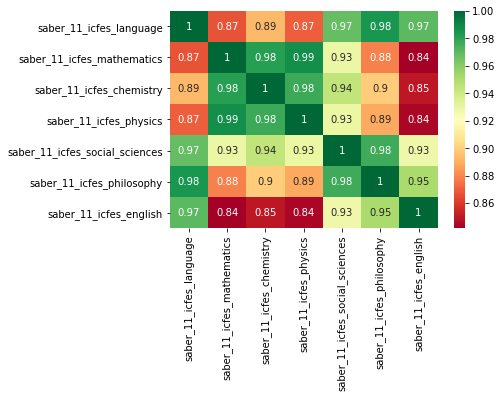

In [108]:
# Subjects Correlation
import seaborn as sns
sns.heatmap(df1.groupby(['undergraduate_core']).mean().corr(),annot=True,cmap='RdYlGn')